# Stop loss & Take profit with vectorbt

- Reference: https://medium.datadriveninvestor.com/stop-loss-trailing-stop-or-take-profit-2-million-backtests-shed-light-dde23bda40be & https://github.com/polakowo/vectorbt/blob/master/examples/StopSignals.ipynb

2. Backtesting stop loss & take profit method for a million times   

In [38]:
seed = 42
symbols = [
    'BTC-USD', 'ETH-USD', 'XRP-USD', 'BCH-USD', 'LTC-USD', 
    'BNB-USD', 'EOS-USD', 'XLM-USD', 'XMR-USD', 'ADA-USD'
]
start_date = "2018-01-01"
end_date = "2021-01-01"
window_len = timedelta(days=180)
window_count = 400
exit_types = ['SL', 'TS', 'TP', 'Random', 'Holding']
step = 0.01  # 1%
stops = np.arange(step, 1 + step, step)

cols = ['Open', 'Low', 'High', 'Close', 'Volume']
yfdata = vbt.YFData.download(symbols, start=start_date, end=end_date)

print(yfdata.data.keys())
print(yfdata.data['BTC-USD'].shape)

dict_keys(['BTC-USD', 'ETH-USD', 'XRP-USD', 'BCH-USD', 'LTC-USD', 'BNB-USD', 'EOS-USD', 'XLM-USD', 'XMR-USD', 'ADA-USD'])
(1097, 7)


In [28]:
ohlcv = yfdata.concat()

print(ohlcv.keys())
print(ohlcv['Open'].shape)

dict_keys(['Open', 'High', 'Low', 'Close', 'Volume', 'Dividends', 'Stock Splits'])
(1097, 10)


In [29]:
split_ohlcv = {}
for k, v in ohlcv.items():
    split_df, split_indexes = v.vbt.range_split(range_len=window_len.days, n=window_count) 
    split_ohlcv[k] = split_df
ohlcv = split_ohlcv
    
print(ohlcv['Open'].shape)

(180, 4000)


In [31]:
entries = pd.DataFrame.vbt.signals.empty_like(ohlcv['Open'])
entries.iloc[0, :] = True

print(entries.shape)

(180, 4000)


In [32]:
# We use OHLCSTX instead of built-in stop-loss in Portfolio.from_signals
# because we want to analyze signals before simulation + it's easier to construct param grids
# For reality check, run the same setup using Portfolio.from_signals alone
sl_exits = vbt.OHLCSTX.run(
    entries, 
    ohlcv['Open'], 
    ohlcv['High'], 
    ohlcv['Low'], 
    ohlcv['Close'], 
    sl_stop=list(stops),
    stop_type=None, 
    stop_price=None
).exits
ts_exits = vbt.OHLCSTX.run(
    entries, 
    ohlcv['Open'], 
    ohlcv['High'], 
    ohlcv['Low'], 
    ohlcv['Close'], 
    sl_stop=list(stops),
    sl_trail=True,
    stop_type=None, 
    stop_price=None
).exits
tp_exits = vbt.OHLCSTX.run(
    entries, 
    ohlcv['Open'], 
    ohlcv['High'], 
    ohlcv['Low'], 
    ohlcv['Close'], 
    tp_stop=list(stops),
    stop_type=None, 
    stop_price=None
).exits

print(sl_exits.shape, ts_exits.shape, tp_exits.shape)

(180, 400000) (180, 400000) (180, 400000)


In [33]:
sl_exits.vbt.rename_levels({'ohlcstx_sl_stop': 'stop_value'}, inplace=True)
ts_exits.vbt.rename_levels({'ohlcstx_sl_stop': 'stop_value'}, inplace=True)
tp_exits.vbt.rename_levels({'ohlcstx_tp_stop': 'stop_value'}, inplace=True)
ts_exits.vbt.drop_levels('ohlcstx_sl_trail', inplace=True)

print(tp_exits.columns)

MultiIndex([(0.01,   0, 'BTC-USD'),
            (0.01,   0, 'ETH-USD'),
            (0.01,   0, 'XRP-USD'),
            (0.01,   0, 'BCH-USD'),
            (0.01,   0, 'LTC-USD'),
            (0.01,   0, 'BNB-USD'),
            (0.01,   0, 'EOS-USD'),
            (0.01,   0, 'XLM-USD'),
            (0.01,   0, 'XMR-USD'),
            (0.01,   0, 'ADA-USD'),
            ...
            ( 1.0, 399, 'BTC-USD'),
            ( 1.0, 399, 'ETH-USD'),
            ( 1.0, 399, 'XRP-USD'),
            ( 1.0, 399, 'BCH-USD'),
            ( 1.0, 399, 'LTC-USD'),
            ( 1.0, 399, 'BNB-USD'),
            ( 1.0, 399, 'EOS-USD'),
            ( 1.0, 399, 'XLM-USD'),
            ( 1.0, 399, 'XMR-USD'),
            ( 1.0, 399, 'ADA-USD')],
           names=['stop_value', 'split_idx', 'symbol'], length=400000)


SL    0.428840
TS    0.588665
TP    0.520338
Name: avg_num_signals, dtype: float64


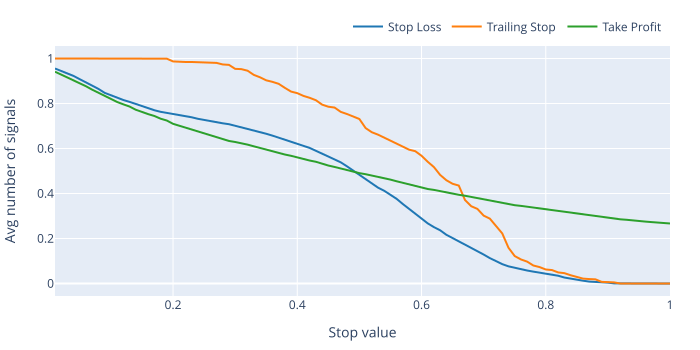

In [34]:
print(pd.Series({
    'SL': sl_exits.vbt.signals.total().mean(),
    'TS': ts_exits.vbt.signals.total().mean(),
    'TP': tp_exits.vbt.signals.total().mean()
}, name='avg_num_signals'))

pd.DataFrame({
    'Stop Loss': sl_exits.vbt.signals.total().groupby('stop_value').mean(),
    'Trailing Stop': ts_exits.vbt.signals.total().groupby('stop_value').mean(),
    'Take Profit': tp_exits.vbt.signals.total().groupby('stop_value').mean()
}).vbt.plot(xaxis_title='Stop value', yaxis_title='Avg number of signals').show_svg()

In [35]:
sl_exits.iloc[-1, :] = True
ts_exits.iloc[-1, :] = True
tp_exits.iloc[-1, :] = True

# Select one exit between two entries
sl_exits = sl_exits.vbt.signals.first(reset_by=entries, allow_gaps=True)
ts_exits = ts_exits.vbt.signals.first(reset_by=entries, allow_gaps=True)
tp_exits = tp_exits.vbt.signals.first(reset_by=entries, allow_gaps=True)

print(pd.Series({
    'SL': sl_exits.vbt.signals.total().mean(),
    'TS': ts_exits.vbt.signals.total().mean(),
    'TP': tp_exits.vbt.signals.total().mean()
}, name='avg_num_signals'))

SL    1.0
TS    1.0
TP    1.0
Name: avg_num_signals, dtype: float64


In [36]:
hold_exits = pd.DataFrame.vbt.signals.empty_like(sl_exits)
hold_exits.iloc[-1, :] = True

print(hold_exits.shape)

(180, 400000)


In [39]:
rand_exits = hold_exits.vbt.shuffle(seed=seed)

print(rand_exits.shape)

(180, 400000)


In [40]:
exits = pd.DataFrame.vbt.concat(
    sl_exits, 
    ts_exits, 
    tp_exits, 
    rand_exits, 
    hold_exits, 
    keys=pd.Index(exit_types, name='exit_type')
)

print(exits.shape)

(180, 2000000)


In [41]:
print(exits.columns)

MultiIndex([(     'SL', 0.01,   0, 'BTC-USD'),
            (     'SL', 0.01,   0, 'ETH-USD'),
            (     'SL', 0.01,   0, 'XRP-USD'),
            (     'SL', 0.01,   0, 'BCH-USD'),
            (     'SL', 0.01,   0, 'LTC-USD'),
            (     'SL', 0.01,   0, 'BNB-USD'),
            (     'SL', 0.01,   0, 'EOS-USD'),
            (     'SL', 0.01,   0, 'XLM-USD'),
            (     'SL', 0.01,   0, 'XMR-USD'),
            (     'SL', 0.01,   0, 'ADA-USD'),
            ...
            ('Holding',  1.0, 399, 'BTC-USD'),
            ('Holding',  1.0, 399, 'ETH-USD'),
            ('Holding',  1.0, 399, 'XRP-USD'),
            ('Holding',  1.0, 399, 'BCH-USD'),
            ('Holding',  1.0, 399, 'LTC-USD'),
            ('Holding',  1.0, 399, 'BNB-USD'),
            ('Holding',  1.0, 399, 'EOS-USD'),
            ('Holding',  1.0, 399, 'XLM-USD'),
            ('Holding',  1.0, 399, 'XMR-USD'),
            ('Holding',  1.0, 399, 'ADA-USD')],
           names=['exit_type', 'stop_value'

exit_type
Holding    179.000000
Random      89.432010
SL         124.463195
TP         113.472037
TS         103.664447
dtype: float64


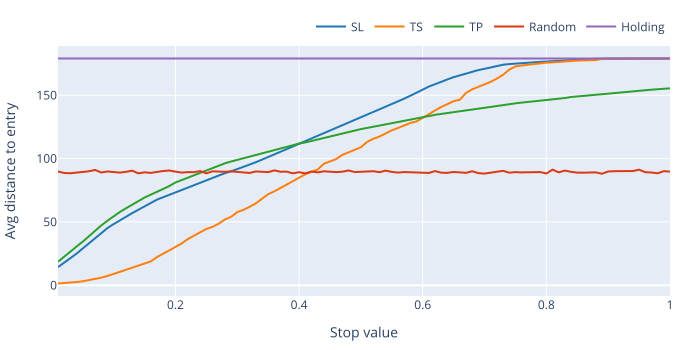

In [42]:
avg_distance = entries.vbt.signals.between_ranges(other=exits)\
    .duration.mean()\
    .groupby(['exit_type', 'stop_value'])\
    .mean()\
    .unstack(level='exit_type')

print(avg_distance.mean())

avg_distance[exit_types].vbt.plot(
    xaxis_title='Stop value', 
    yaxis_title='Avg distance to entry'
).show_svg()

In [43]:
# del pf

from tqdm.auto import tqdm
import gc

total_returns = []

for i in tqdm(range(len(exit_types))):
    chunk_mask = exits.columns.get_level_values('exit_type') == exit_types[i]
    chunk_exits = exits.loc[:, chunk_mask]
    chunk_pf = vbt.Portfolio.from_signals(ohlcv['Close'], entries, chunk_exits)
    total_returns.append(chunk_pf.total_return())
    
    del chunk_pf
    gc.collect()
    
total_return = pd.concat(total_returns)

print(total_return.shape)

  0%|          | 0/5 [00:00<?, ?it/s]

(2000000,)


count    400000.000000
mean          0.099110
std           0.836598
min          -0.914480
50%          -0.129430
max           6.601642
Name: Holding, dtype: float64


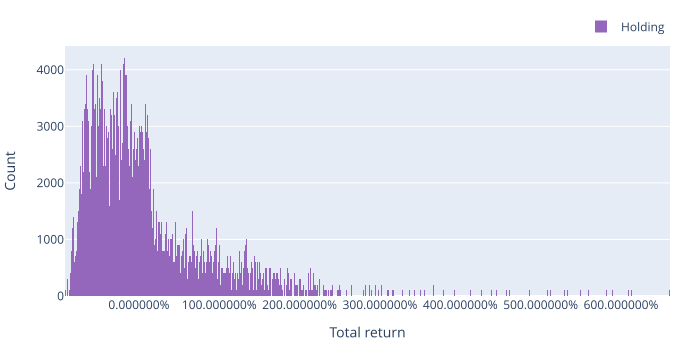

In [44]:
total_return_by_type = total_return.unstack(level='exit_type')[exit_types]

print(total_return_by_type['Holding'].describe(percentiles=[]))

total_return_by_type['Holding'].vbt.histplot(
    xaxis_title='Total return',
    xaxis_tickformat='%',
    yaxis_title='Count',
    trace_kwargs=dict(marker_color=vbt.settings['plotting']['color_schema']['purple'])
).show_svg()

In [45]:
print(pd.DataFrame({
    'Mean': total_return_by_type.mean(),
    'Median': total_return_by_type.median(),
    'Std': total_return_by_type.std(),
}))

total_return_by_type.vbt.boxplot(
    yaxis_title='Total return',
    yaxis_tickformat='%'
).show_svg()

               Mean    Median       Std
exit_type                              
SL         0.064233 -0.152714  0.771367
TS         0.063744 -0.093794  0.703309
TP         0.056703  0.089343  0.485956
Random     0.036212 -0.063269  0.579912
Holding    0.099110 -0.129430  0.836598
